<a href="https://colab.research.google.com/github/adrianzevenster/ColabNoteboks/blob/main/tensorbarcode.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Importing Pre-Trained TensorFlow Model for object / barcode detection and isolation

Author: A C Zevenster, 2024

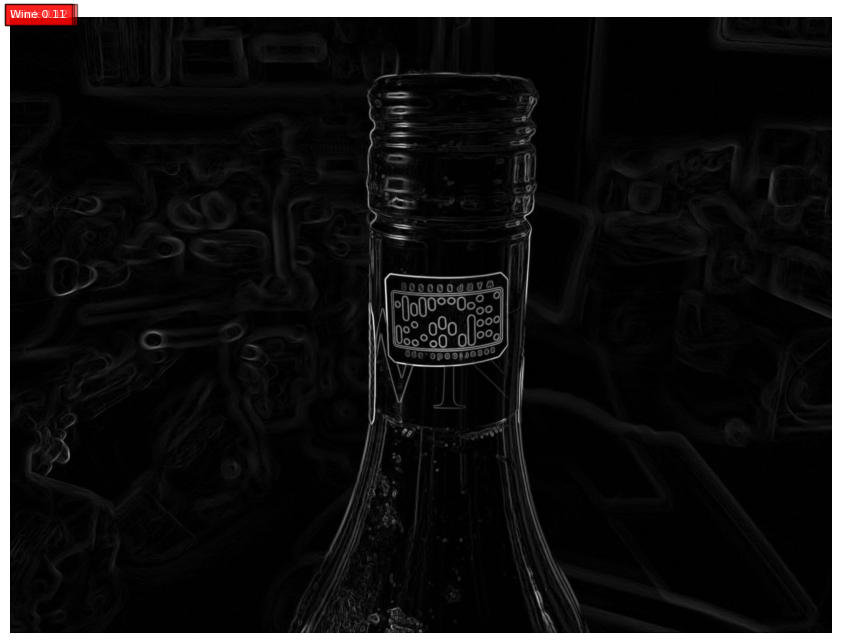

[]

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow_hub as hub

# Load the model from TensorFlow Hub
model_handle = 'https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1'
detector = hub.load(model_handle)

'''load_img(): Conversion of Image to Suit Tensor Dimensions'''
def load_img(path):
    img = Image.open(path)
    img = img.convert('RGB')
    img = np.array(img).astype(np.uint8)  # Convert to uint8 data type
    return img

def run_detector(detector, img):
    converted_img = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

    try:
        # Attempt to use the serving_default signature
        result = detector.signatures['default'](converted_img)
    except ValueError:
        # If the serving_default signature is not available, list available signatures
        available_signatures = list(detector.signatures.keys())
        print(f"No 'serving_default' signature found. Available signatures: {available_signatures}")
        if available_signatures:
            # Try using the first available signature as a fallback
            signature_key = available_signatures[0]
            result = detector.signatures[signature_key](converted_img)
        else:
            # If there are no signatures available, raise an error
            raise ValueError("No signatures are available for this model.")

    result = {key: value.numpy() for key, value in result.items()}
    return result

def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    ax = plt.gca()

    barcode_boxes = []

    for i in range(min(boxes.shape[0], max_boxes)):
        if scores[i] >= min_score:
            box = boxes[i]
            y1, x1, y2, x2 = box
            rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
            ax.add_patch(rect)
            class_name = class_names[i].decode("ascii")
            score = scores[i]
            label = f'{class_name} {score:.2f}'
            ax.text(x1, y1, label, color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))

            # Save the box if the detected class is a barcode
            if class_name == 'Barcode':
                barcode_boxes.append((y1, x1, y2, x2))

    plt.axis('off')
    plt.show()

    # Return the list of barcode boxes
    return barcode_boxes

image_path = '/content/SecuriEnv.png'  # Adjust path as necessary
img = load_img(image_path)

# Object detector
result = run_detector(detector, img)

# Bounding Boxes around Detected
barcode_boxes = draw_boxes(img, result["detection_boxes"], result["detection_class_entities"], result["detection_scores"])


if barcode_boxes:

    y1, x1, y2, x2 = barcode_boxes[0]
    height, width, _ = img.shape
    barcode_img = img[int(y1 * height):int(y2 * height), int(x1 * width):int(x2 * width)]


    plt.figure(figsize=(6, 3))
    plt.imshow(barcode_img)
    plt.axis('off')
    plt.show()


def extract_barcode(image, box):

    img_height, img_width, _ = image.shape

    # Crop the image to the bounding box can be adjusted here
    # cropped_img = image[int(top):int(bottom), int(left):int(right)]

    # Grayscale
    gray_image = tf.image.rgb_to_grayscale(image)

    # Ggrayscale image to binary
    binary_image = tf.image.convert_image_dtype(gray_image, tf.uint8)
    threshold = tf.reduce_mean(binary_image)
    binary_image = tf.where(binary_image < threshold, 0, 1)

    # image to Numpy
    binary_matrix = binary_image.numpy().squeeze()

    return binary_matrix

matrices =  extract_barcode(img, result["detection_boxes"])
barcode_boxes

In [ ]:
def run_detector(detector, img):
    converted_img = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

    try:
        # Attempt to use the serving_default signature
        result = detector.signatures['serving_default'](converted_img)
    except ValueError:
        # If the serving_default signature is not available, list available signatures
        available_signatures = list(detector.signatures.keys())
        print(f"No 'serving_default' signature found. Available signatures: {available_signatures}")
        if available_signatures:
            # Try using the first available signature as a fallback
            signature_key = available_signatures[0]
            result = detector.signatures[signature_key](converted_img)
        else:
            # If there are no signatures available, raise an error
            raise ValueError("No signatures are available for this model.")

    result = {key: value.numpy() for key, value in result.items()}
    return result

def extract_barcode(image, box):

    # De-normalize the bounding box coordinates
    img_height, img_width, _ = image.shape
    ymin, xmin, ymax, xmax = box
    (left, right, top, bottom) = (xmin * img_width, xmax * img_width,
                                  ymin * img_height, ymax * img_height)

    # Crop the image to the bounding box
    cropped_img = image[int(top):int(bottom), int(left):int(right)]

    # Grayscale
    gray_image = tf.image.rgb_to_grayscale(cropped_img)

    # Convert the grayscale image to binary
    binary_image = tf.image.convert_image_dtype(gray_image, tf.uint8)
    threshold = tf.reduce_mean(binary_image)
    binary_image = tf.where(binary_image < threshold, 0, 1)

    # Convert the binary image to a numpy matrix
    binary_matrix = binary_image.numpy().squeeze()

    return binary_matrix

# def run_detector2(detector, img):
#     converted_img = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
#     result = detector(converted_img)
#     result = {key: value.numpy() for key, value in result.items()}
#     print("Found %d objects." % len(result["detection_scores"]))
#     image_with_boxes = draw_boxes(
#         img, result['detection_boxes'], result['detection_class_entities'], result['detection_scores'])
#     return image_with_boxes

Binary Conversion of Image and Converted into Matrices of Binary Values

Function to plot as binary with conversions

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

# Function to display an image with a bounding box
def plot_image_with_bbox(image, bbox, title="Image with Bounding Box"):
    # Create figure and axes
    fig, ax = plt.subplots(1, figsize=(8, 8))

    # Display the image
    ax.imshow(image)

    # De-normalize the bounding box coordinates
    img_height, img_width, _ = image.shape
    ymin, xmin, ymax, xmax = bbox
    box_width = (xmax - xmin) * img_width
    box_height = (ymax - ymin) * img_height
    rect = patches.Rectangle((xmin * img_width, ymin * img_height), box_width, box_height,
                             linewidth=2, edgecolor='r', facecolor='none')


    ax.add_patch(rect)
    plt.title(title)
    plt.axis('off')
    plt.show()

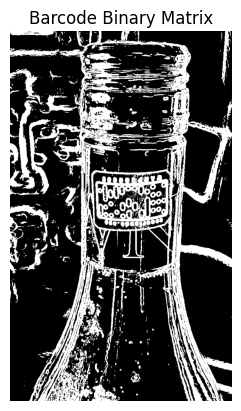

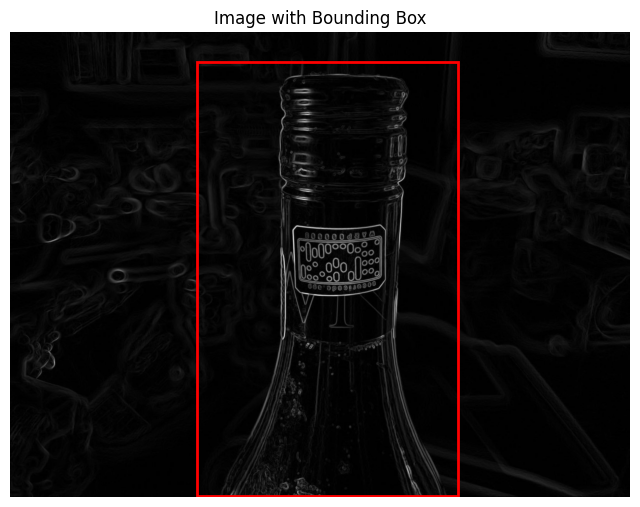

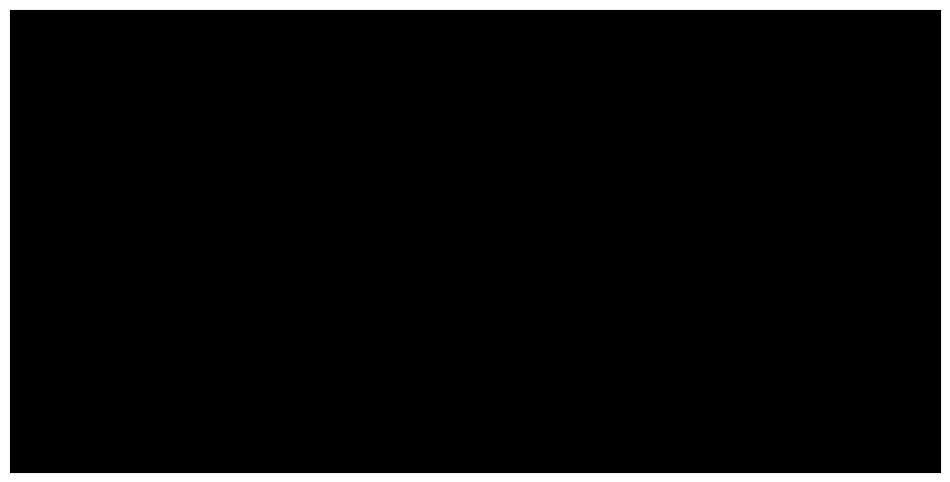

In [ ]:
import pandas as pd
def extract_barcode(image, box):

    img_height, img_width, _ = image.shape
    ymin, xmin, ymax, xmax = box
    (left, right, top, bottom) = (xmin * img_width, xmax * img_width,
                                  ymin * img_height, ymax * img_height)

#Crop
    cropped_img = image[int(top):int(bottom), int(left):int(right)]

    # grayscale
    gray_image = tf.image.rgb_to_grayscale(cropped_img)

    binary_image = tf.image.convert_image_dtype(gray_image, tf.uint8)
    threshold = tf.reduce_mean(binary_image)
    binary_image = tf.where(binary_image < threshold, 0, 1)


    binary_matrix = binary_image.numpy().squeeze()

    return binary_matrix


bbox = result['detection_boxes'][0]  # Assuming the first detection is the barcode


barcode_matrix = extract_barcode(img, bbox)
plt.imshow(barcode_matrix, cmap='gray')
plt.title('Barcode Binary Matrix')
plt.axis('off')
plt.show()

# matrix_frame2 = pd.
import pandas as pd

def style_binary_matrix(df):
    return df.style.applymap(lambda x: 'background-color: black' if x == 0 else 'background-color: white')

# Binary to DataFrame
matrix_frame = pd.DataFrame(barcode_matrix)

# Apply styling
styled_matrix = style_binary_matrix(matrix_frame)
display(styled_matrix)

import matplotlib.pyplot as plt
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

# Function to display an image with a bounding box
def plot_image_with_bbox(image, bbox, title="Image with Bounding Box"):

    fig, ax = plt.subplots(1, figsize=(8, 8))


    ax.imshow(image)


    img_height, img_width, _ = image.shape
    ymin, xmin, ymax, xmax = bbox
    box_width = (xmax - xmin) * img_width
    box_height = (ymax - ymin) * img_height
    rect = patches.Rectangle((xmin * img_width, ymin * img_height), box_width, box_height,
                             linewidth=2, edgecolor='r', facecolor='none')


    ax.add_patch(rect)
    plt.title(title)
    plt.axis('off')  # Hide axes ticks
    plt.show()

plot_image_with_bbox(img, bbox)

def plot_matrix(matrix):
    fig, ax = plt.subplots(figsize=(12, 6))
    ax.imshow(matrix, cmap='gray', aspect='auto')
    # Draw gridlines based on matrix size
    ax.set_xticks(np.arange(-0.5, len(matrix[0]), 1), minor=True)
    ax.set_yticks(np.arange(-0.5, len(matrix), 1), minor=True)
    ax.grid(which='minor', color='black', linestyle='-', linewidth=2)
    ax.tick_params(which='minor', size=0)
    plt.xticks([])
    plt.yticks([])
    plt.show()


plot_matrix(barcode_matrix)